In [1]:
# Solve 1D advection equation using various finite difference methods.
#
# UC Berkeley Math 228B, Per-Olof Persson <persson@berkeley.edu>

using PyPlot, PyCall, LinearAlgebra

In [2]:
@pyimport IPython.display as d
"""
    mkanim(x, allu)

Utility for animating PDE solutions in a Jupyter notebook.
"""
function mkanim(x, allu)
    animation = pyimport("matplotlib.animation");
    fig, ax = subplots(figsize=(6,4.5))
    function update(frame)
        ax.clear()
        ax.plot(x, allu[frame+1])
        #if frame+1 == numel(allu)
            ax.plot(x, allu[1], "--")
        #end
        ax.set_xlim([0, 1])
        ax.set_ylim([-0.1, 1.1])
        ax.grid(true);
    end
    ani = animation.FuncAnimation(fig, update, frames=length(allu), interval=50)
    close(ani._fig)
    d.HTML(ani.to_jshtml())
end

mkanim

In [3]:
"""
    error = advection_fdm(method="LF", m=100; T=1.0, kmul=0.8)

Solves the 1D advection equation, du/dt + du/dx = 0, on the periodic domain 0 <= x <= 1.
Uses the finite difference scheme `method`, grid size `m`, and timestep multiplier `kmul`.
Integrates until final time `T` and returns the grid x and all the solutions.
Returns error in max-norm (assuming T is an integer).
"""
function advection_fdm(method="LF", m=100; T=1.0, kmul=0.8)
    # Discretization
    h = 1 / m
    x = h * (1:m)
    k = kmul * h
    
    uinit = @. exp(-(x - 0.25)^2 / 0.1^2) + exp(-(x - 0.75)^2 / 0.025^2)
    
    u = copy(uinit)
    allu = [copy(u)]
    for n = 1:ceil(T/k)
        uext = u[[end-1:end; 1:end; 1:2]]
        uR2 = uext[5:end]
        uR1 = uext[4:end-1]
        u0  = uext[3:end-2]
        uL1 = uext[2:end-3]
        uL2 = uext[1:end-4]

        if method == "LF" # Lax-Friedrichs
            @. u = 0.5*(uR1 + uL1) - k/(2h) * (uR1 - uL1)
        elseif method == "LW" # Lax-Wendroff
            @. u = u0 - k/(2h) * (uR1 - uL1) + k^2/(2*h^2) * (uR1 - 2u0 + uL1)
        elseif method == "UW" # Upwind
            @. u = u0 - k/h * (u0 - uL1)
        elseif method == "BW" # Beam-Warming
            @. u = u0 - k/(2h) * (3u0 - 4uL1 + uL2) +
                   k^2/(2*h^2) * (u0 - 2*uL1 + uL2)
        else
            error("Unknown method")
        end
 
        push!(allu, copy(u))    # Save solution
    end

    error = maximum(abs.(u - uinit))
    println("Maximum error = $error")
    x,allu
end

advection_fdm

In [4]:
x,allu = advection_fdm("LF")
mkanim(x,allu)

Maximum error = 0.7465075718147258


PyObject <IPython.core.display.HTML object>

In [5]:
x,allu = advection_fdm("LW")
mkanim(x,allu)

Maximum error = 0.39385024307148997


PyObject <IPython.core.display.HTML object>

In [6]:
x,allu = advection_fdm("UW")
mkanim(x,allu)

Maximum error = 0.6332182861976101


PyObject <IPython.core.display.HTML object>

In [7]:
x,allu = advection_fdm("BW")
mkanim(x,allu)

Maximum error = 0.43241254184975253


PyObject <IPython.core.display.HTML object>

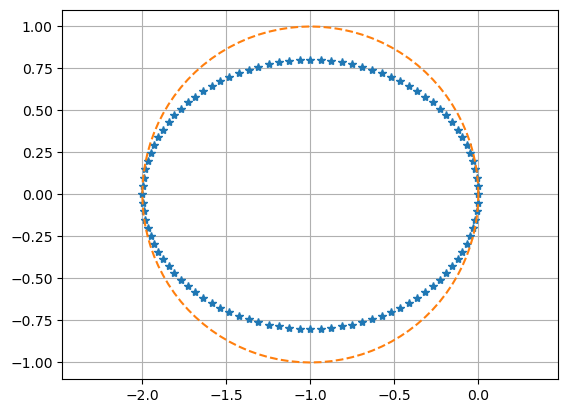

In [8]:
"""
    advection_eigen(method="LF", m=100; kmul=0.8)

1D advection equation, du/dt + du/dx = 0, periodic 0 <= x <= 1.
Study eigenvalue structure for finite difference scheme `method`, grid size `m`,
and timestep multiplier `kmul`.
"""
function advection_eigen(method="LF", m=100; kmul=0.8)

    function rhs(u, h, k, method)
        uext = u[[end-1:end; 1:end; 1:2]]
        uR2 = uext[5:end]
        uR1 = uext[4:end-1]
        u0  = uext[3:end-2]
        uL1 = uext[2:end-3]
        uL2 = uext[1:end-4]

        if method == "LF" # Lax-Friedrichs
            return @. -1/(2h) * (uR1 - uL1) + 0.5/k * (uR1 -2u0 + uL1)
        elseif method == "LW" # Lax-Wendroff
            return @. -1/(2h) * (uR1-uL1) + k/(2h^2) * (uR1 -2u0 + uL1)
        elseif method == "UW" # Upwind
            return @. - 1/h * (u0 - uL1)
        elseif method == "BW" # Beam-Warming
            return @. - 1/(2h) * (3u0 - 4uL1 + uL2) + k/(2h^2) * (u0 -2uL1 + uL2)
        else
            error("Unknown method")
        end
    end

    function mkmatrix(h, k, method)
        m = ceil(Int, 1 / h)
        A = zeros(m,m)
        for i = 1:m
            u = zeros(m)
            u[i]=1
            A[:,i] = rhs(u, h, k, method)
        end
        return A
    end
    
    h = 1 / m
    k = kmul*h

    A = mkmatrix(h, k, method)
    l = eigvals(A)

    phi = 2π * (0:100) / 100
    clf(); grid(true); axis("equal");
    plot(k*real(l), k*imag(l), "*", cos.(phi) .- 1, sin.(phi), "--")
    return
end

advection_eigen("LF")